<script>
    function luc21893_refresh_cell(cell) {
        if( cell.luc21893 ) return;
        cell.luc21893 = true;
        console.debug('New code cell found...' );
        
        var div = document.createElement('DIV');            
        cell.parentNode.insertBefore( div, cell.nextSibling );
        div.style.textAlign = 'right';
        var a = document.createElement('A');
        div.appendChild(a);
        a.href='#'
        a.luc21893 = cell;
        a.setAttribute( 'onclick', "luc21893_toggle(this); return false;" );

        cell.style.visibility='hidden';
        cell.style.position='absolute';
        a.innerHTML = '[show code]';        
                
    }
    function luc21893_refresh() {                
        if( document.querySelector('.code_cell .input') == null ) {            
            // it apeears that I am in a exported html
            // hide this code
            var codeCells = document.querySelectorAll('.jp-InputArea')
            codeCells[0].style.visibility = 'hidden';
            codeCells[0].style.position = 'absolute';                        
            for( var i = 1; i < codeCells.length; i++ ) {
                luc21893_refresh_cell(codeCells[i].parentNode)
            }
            window.onload = luc21893_refresh;
        }                 
        else {
            // it apperas that I am in a jupyter editor
            var codeCells = document.querySelectorAll('.code_cell .input')
            for( var i = 0; i < codeCells.length; i++ ) {
                luc21893_refresh_cell(codeCells[i])
            }            
            window.setTimeout( luc21893_refresh, 1000 )
        }        
    }
    
    function luc21893_toggle(a) {
        if( a.luc21893.style.visibility=='hidden' ) {
            a.luc21893.style.visibility='visible';        
            a.luc21893.style.position='';
            a.innerHTML = '[hide code]';
        }
        else {
            a.luc21893.style.visibility='hidden';        
            a.luc21893.style.position='absolute';
            a.innerHTML = '[show code]';
        }
    }
    
    luc21893_refresh()
</script>

In [ ]:
#instalacja bibliotek

install.packages('units')
install.packages('GWmodel')
install.packages('h2o')
install.packages('raster')
install.packages('gridExtra')
install.packages('pdp')
install.packages('vip')
install.packages('ggmap')
install.packages('SpatialML')
install.packages('osmdata')
install.packages('spgwr')
install.packages('gstat')
install.packages('latticeExtra')
install.packages('RStoolbox')
install.packages('geosphere')
install.packages('GGally')

In [ ]:
#wczytanie pakietow
library(GWmodel)
library(h2o)
library(plyr)
library(dplyr)
library(sp)
library(spdep)
library(RColorBrewer)
library(classInt)
library(raster)
library(grid)
library(gridExtra)
library(ggplot2)
library(pdp)
library(vip)
library(ggmap)
library(tidyverse) 
library(SpatialML)
library(geosphere)
library(osmdata)
library(spgwr)
library(gstat)
library(latticeExtra)
library(RStoolbox)
library(reshape2)
library(GGally)

options(warn=-1)
options(repr.plot.width=15, repr.plot.height=10)

In [ ]:
#wczytanie csv

df<-read.csv("pekin.csv")
#Bazy danych stacji
sub_2017 = read_csv('pekin_sub_2017.csv')
sub_2016 = read_csv('pekin_sub_2016.csv')
sub_2015 = read_csv('pekin_sub_2015.csv')
df$constructionTime = as.numeric(df$constructionTime)
#obliczenie wieku budynku
df$year = df$tradeTime - df$constructionTime
df = na.omit(df)
map_pekin = get_map(location = getbb("pekin"), zoom = 13, source = "stamen")

In [ ]:
#utworzenie zbioru testowego, treningowego i walidacyjnego
test.df<-df %>% 
  dplyr::select(Lng, Lat, tradeTime, square, livingRoom, drawingRoom, kitchen, bathRoom, floor, buildingType,
       year, renovationCondition, buildingStructure, ladderRatio, elevator, price) %>%
  filter(tradeTime == 2017)

valid.df<-df %>% 
  dplyr::select(Lng, Lat, tradeTime, square, livingRoom, drawingRoom, kitchen, bathRoom, floor, buildingType,
       year, renovationCondition, buildingStructure, ladderRatio, elevator, price) %>%
  filter(tradeTime == 2016)
train.df<-df %>% 
  dplyr::select(Lng, Lat, tradeTime, square, livingRoom, drawingRoom, kitchen, bathRoom, floor, buildingType,
       year, renovationCondition, buildingStructure, ladderRatio, elevator, price) %>%
  filter(tradeTime == 2015 )

set.seed(384365)
train.df <- train.df[sample(nrow(train.df), 2000), ]
valid.df <- valid.df[sample(nrow(valid.df), 1000), ]
test.df <- test.df[sample(nrow(test.df), 500), ]



In [ ]:
#Petle do dodania dystansu od centrum i najblizszego metra
sub_dist = c()
centre_dist = c()
for(i in 1:length(train.df$Lng)) { 

  min_dist = c()
  for(m in 1:length(sub_2015$Lng)) { 
    min_dist[m] = distHaversine(c(train.df$Lng[i], train.df$Lat[i]), c(sub_2015$Lat[m], sub_2015$Lng[m])) / 1000
  }
sub_dist[i] = min(min_dist)
centre_dist[i] = distHaversine(c(train.df$Lng[i], train.df$Lat[i]), c(116.383331,  39.916668)) / 1000
}
train.df$sub_dist = sub_dist
train.df$centre_dist = centre_dist

sub_dist = c()
centre_dist = c()
for(i in 1:length(valid.df$Lng)) { 

  min_dist = c()
  for(m in 1:length(sub_2016$Lng)) { 
    min_dist[m] = distHaversine(c(valid.df$Lng[i], valid.df$Lat[i]), c(sub_2016$Lat[m], sub_2016$Lng[m])) / 1000
  }
sub_dist[i] = min(min_dist)
centre_dist[i] = distHaversine(c(valid.df$Lng[i], valid.df$Lat[i]), c(116.383331,  39.916668)) / 1000
}
valid.df$sub_dist = sub_dist
valid.df$centre_dist = centre_dist


sub_dist = c()
centre_dist = c()
for(i in 1:length(test.df$Lng)) { 

  min_dist = c()
  for(m in 1:length(sub_2017$Lng)) { 
    min_dist[m] = distHaversine(c(test.df$Lng[i], test.df$Lat[i]), c(sub_2017$Lat[m], sub_2017$Lng[m])) / 1000
  }
sub_dist[i] = min(min_dist)
centre_dist[i] = distHaversine(c(test.df$Lng[i], test.df$Lat[i]), c(116.383331,  39.916668)) / 1000
}
test.df$sub_dist = sub_dist
test.df$centre_dist = centre_dist


#zlaczenie danych do jednego dataframe
df <- bind_rows(train.df, valid.df, test.df)


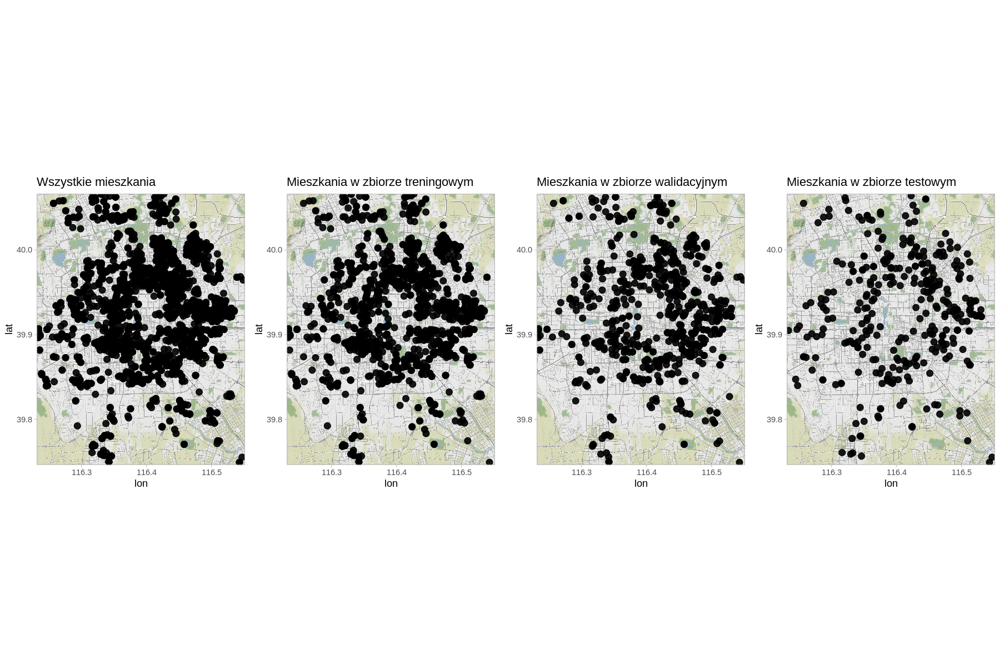

In [ ]:
#podzial zbioru
df_map = ggmap(map_pekin) +
  geom_point(data=df, aes(x=Lng, y=Lat), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7))+
  theme_light() +
  ggtitle("Wszystkie mieszkania")

train_map = ggmap(map_pekin) +
  geom_point(data=train.df, aes(x=Lng, y=Lat), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7))+
  theme_light() +
  ggtitle("Mieszkania w zbiorze treningowym")

valid_map = ggmap(map_pekin) +
  geom_point(data=valid.df, aes(x=Lng, y=Lat), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7))+
  theme_light() +
  ggtitle("Mieszkania w zbiorze walidacyjnym")


test_map = ggmap(map_pekin) +
  geom_point(data=test.df, aes(x=Lng, y=Lat), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7))+
  theme_light() +
  ggtitle("Mieszkania w zbiorze testowym")


grid.arrange(df_map, train_map,valid_map,test_map, nrow = 1)

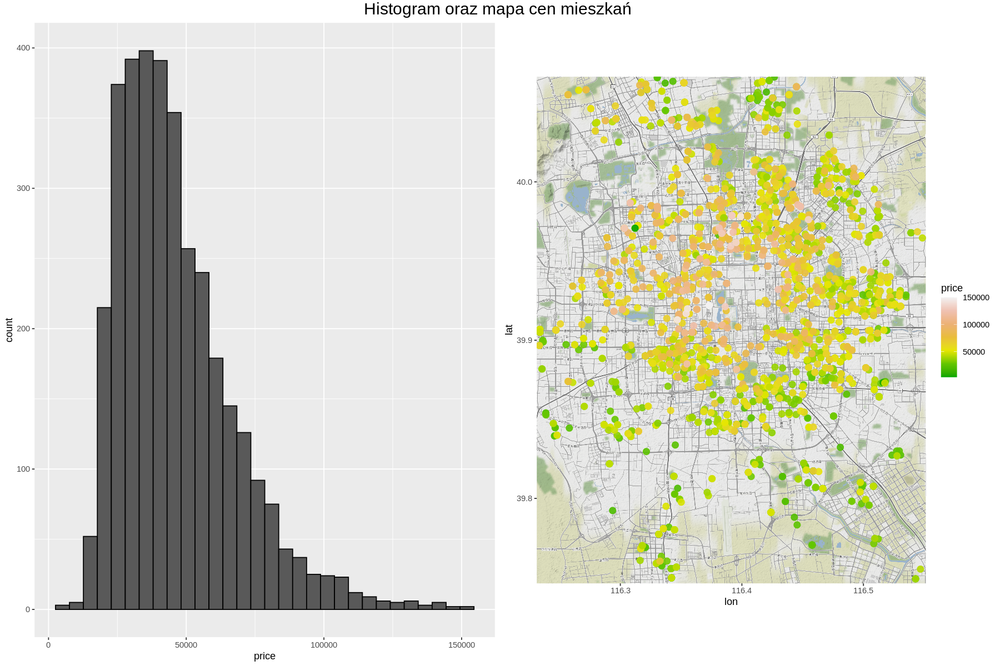

In [ ]:
hist_price = ggplot(df, aes(x = price)) +
  geom_histogram(bins = 30, color = "black")

map_price = ggmap(map_pekin) +
geom_point(data=df, aes(x=Lng, y=Lat, color=price), alpha=0.9, size=3) + 
scale_colour_gradientn(colours = terrain.colors(n = 7)) 


grid.arrange(hist_price, map_price, nrow = 1, top = textGrob("Histogram oraz mapa cen mieszkań ", gp=gpar(fontsize=18)))

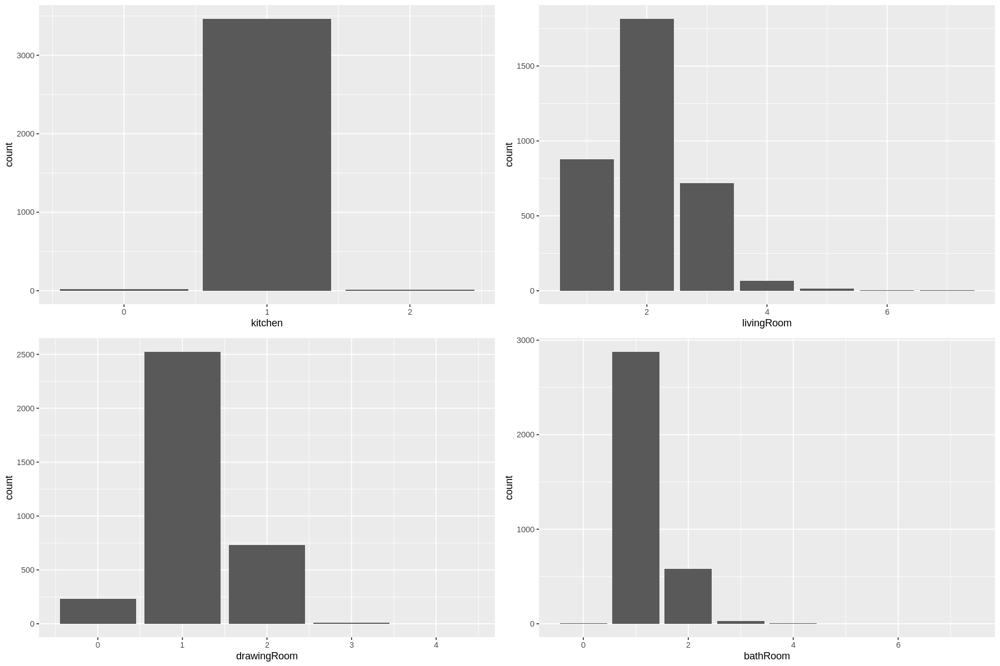

In [ ]:
kitchen = ggplot(df, aes(x = kitchen)) +
  geom_bar( stat = "count")

living = ggplot(df, aes(x = livingRoom)) +
  geom_bar( stat = "count")

drawing = ggplot(df, aes(x = drawingRoom)) +
  geom_bar( stat = "count")

bath = ggplot(df, aes(x = bathRoom)) +
  geom_bar( stat = "count")

grid.arrange(kitchen, living,drawing,bath, nrow = 2, widths = c(30, 30))

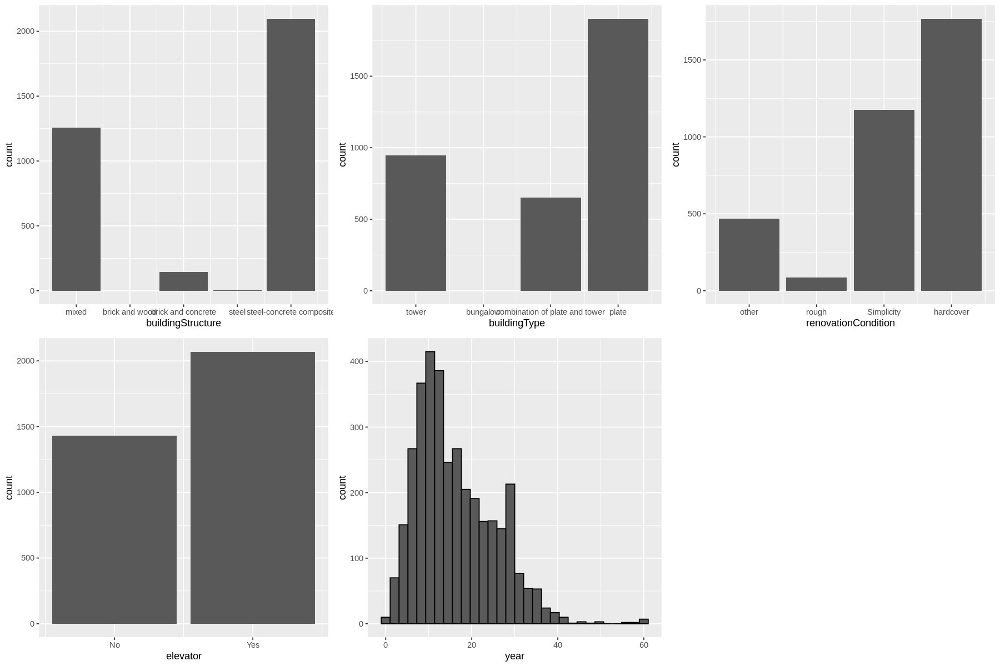

In [ ]:
#Budynki

structure = ggplot(df, aes(x=buildingStructure)) + 
  geom_bar() +
  scale_x_continuous(breaks=c(2,3,4,5,6), labels=c("mixed", "brick and wood", "brick and concrete", 'steel', 'steel-concrete composite'))

type = ggplot(df, aes(x=buildingType)) + 
  geom_bar() +
  scale_x_continuous(breaks=c(1,2,3,4), labels=c("tower", "bungalow", "combination of plate and tower", 'plate'))


renovation = ggplot(df, aes(x=renovationCondition)) + 
  geom_bar() +
  scale_x_continuous(breaks=c(1,2,3,4), labels=c("other", "rough", "Simplicity", 'hardcover'))

elev = ggplot(df, aes(x=elevator)) + 
  geom_bar() +
  scale_x_continuous(breaks=c(0,1), labels=c("No", "Yes"))

age = ggplot(df, aes(x = year)) +
  geom_histogram(bins = 30, color = "black")

grid.arrange(structure, type,renovation,elev,age,nrow = 2)

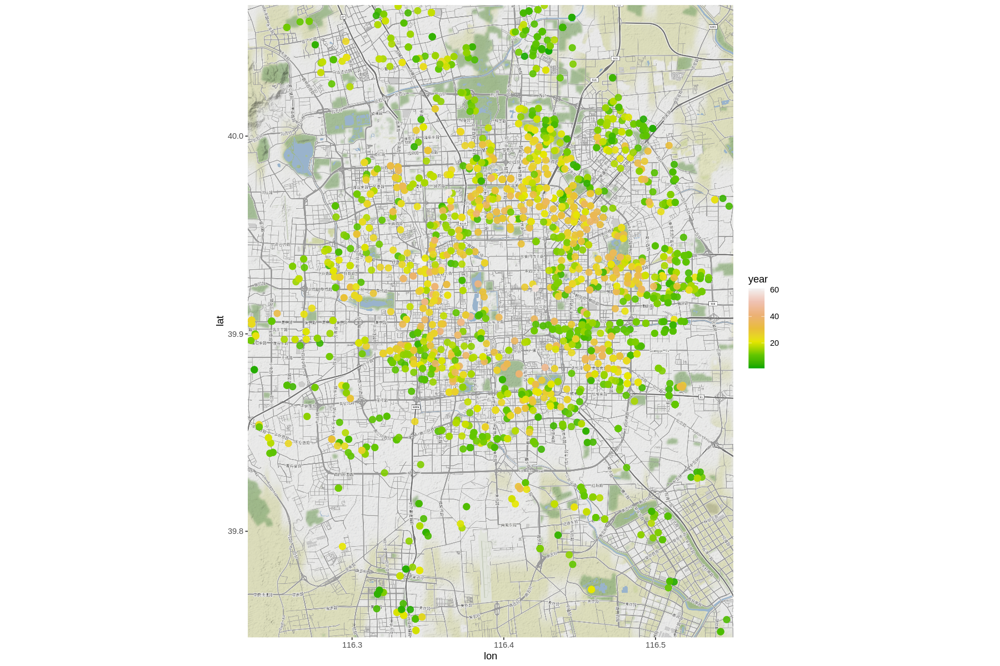

In [ ]:
ggmap(map_pekin) +
geom_point(data=df, aes(x=Lng, y=Lat, color=year), alpha=0.9, size=3) + 
scale_colour_gradientn(colours = terrain.colors(n = 7)) 

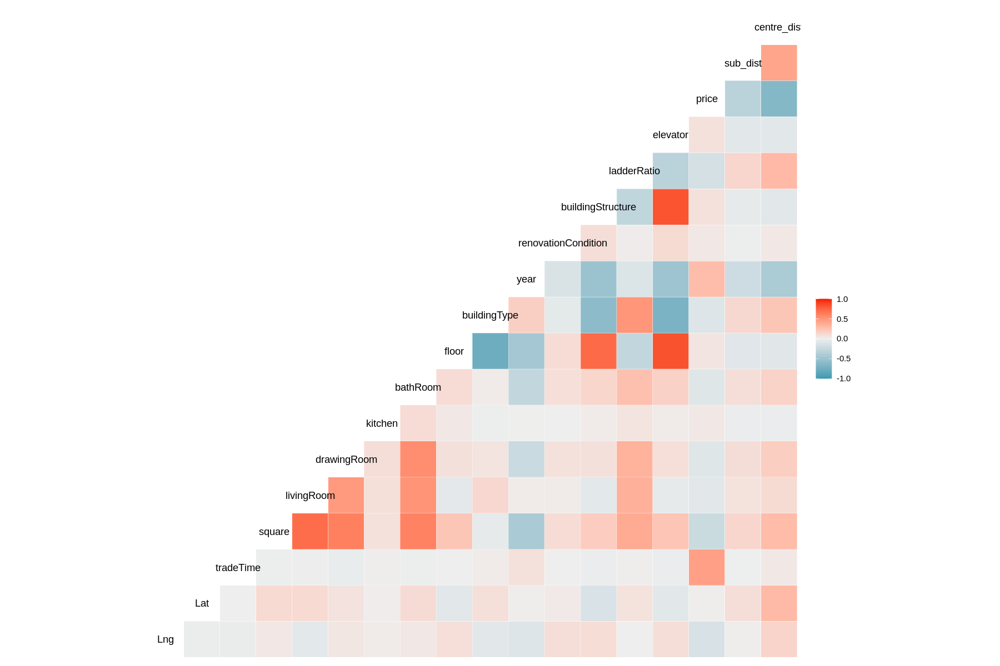

In [ ]:
ggcorr(df,method = c("complete", "spearman"))


In [ ]:
summary(df)

      Lng             Lat          tradeTime        square      
 Min.   :116.1   Min.   :39.63   Min.   :2015   Min.   : 12.30  
 1st Qu.:116.3   1st Qu.:39.89   1st Qu.:2015   1st Qu.: 57.89  
 Median :116.4   Median :39.93   Median :2015   Median : 73.48  
 Mean   :116.4   Mean   :39.95   Mean   :2016   Mean   : 82.40  
 3rd Qu.:116.5   3rd Qu.:39.99   3rd Qu.:2016   3rd Qu.: 98.20  
 Max.   :116.7   Max.   :40.24   Max.   :2017   Max.   :399.71  
   livingRoom     drawingRoom       kitchen          bathRoom    
 Min.   :1.000   Min.   :0.000   Min.   :0.0000   Min.   :0.000  
 1st Qu.:1.000   1st Qu.:1.000   1st Qu.:1.0000   1st Qu.:1.000  
 Median :2.000   Median :1.000   Median :1.0000   Median :1.000  
 Mean   :2.013   Mean   :1.148   Mean   :0.9983   Mean   :1.185  
 3rd Qu.:2.000   3rd Qu.:1.000   3rd Qu.:1.0000   3rd Qu.:1.000  
 Max.   :7.000   Max.   :4.000   Max.   :2.0000   Max.   :7.000  
     floor        buildingType        year      renovationCondition
 Min.   : 1.00 

Najdalsze mieszkanie od punktu centrum jest oddalone o niecałe 41 km, natomiast najbliższe znajduje się ok 400 metrów od centrum Pekinu. Mieszkanie najbardziej oddalone od metra ma 9,77km odległości. 

In [ ]:
h2o.init(nthreads = -1,max_mem_size ="48g",enable_assertions = FALSE)

#Przygotowanie danych
test.mf<-test.df[, 4:18] 
valid.mf<-valid.df[, 4:18]
train.mf<-train.df[, 4:18]
test.hex<-  as.h2o(test.mf)
valid.hex<-  as.h2o(valid.mf)
train.hex<-  as.h2o(train.mf)

response <- "price"
predictors <- setdiff(names(train.hex), response)


In [ ]:
drf_hyper_params <-list(
              ntrees  = seq(10, 1000, by = 10),
              max_depth=seq(5, 40, by = 5),
              sample_rate=c(0.7, 0.8, 0.9, 1.0)
              )

#  Szukanie kryteriów
drf_search_criteria <- list(strategy = "RandomDiscrete", 
                        max_models = 30,
                        max_runtime_secs = 900,
                        stopping_tolerance = 0.001,
                        stopping_rounds = 2,
                        seed = 384365)
# Grid search
drf_grid <- h2o.grid(
                  algorithm="randomForest",
                  grid_id = "drf_grid_IDx",
                  x= predictors,
                  y = response,
                  training_frame = train.hex,
                  validation_frame = valid.hex,
                  stopping_metric = "RMSE",
                  nfolds=5,
                  keep_cross_validation_predictions = TRUE,
                  hyper_params = drf_hyper_params,
                  search_criteria = drf_search_criteria,
                  seed = 42)


In [ ]:
drf_get_grid <- h2o.getGrid("drf_grid_IDx",sort_by="RMSE",decreasing= FALSE)
drf_get_grid@summary_table[1,]

,max_depth,ntrees,sample_rate,model_ids,rmse
,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
1,40,430,0.8,drf_grid_IDx_model_1,8998.906


In [ ]:
#Statystyki modelu
best_drf <- h2o.getModel(drf_get_grid@model_ids[[1]]) 
best_drf


Model Details:

H2ORegressionModel: drf
Model ID:  drf_grid_IDx_model_1 
Model Summary: 
  number_of_trees number_of_internal_trees model_size_in_bytes min_depth
1             430                      430             8366410        21
  max_depth mean_depth min_leaves max_leaves mean_leaves
1        31   25.85116       1499       1587  1544.91160


H2ORegressionMetrics: drf
** Reported on training data. **
** Metrics reported on Out-Of-Bag training samples **

MSE:  77118264
RMSE:  8781.7
MAE:  6032.94
RMSLE:  0.2056017
Mean Residual Deviance :  77118264


H2ORegressionMetrics: drf
** Reported on validation data. **

MSE:  403901544
RMSE:  20097.3
MAE:  14818.78
RMSLE:  0.3843689
Mean Residual Deviance :  403901544


H2ORegressionMetrics: drf
** Reported on cross-validation data. **
** 5-fold cross-validation on training data (Metrics computed for combined holdout predictions) **

MSE:  80980306
RMSE:  8998.906
MAE:  6241.497
RMSLE:  0.2108124
Mean Residual Deviance :  80980306


Cross

In [ ]:
cv.drf<-best_drf@model$cross_validation_metrics_summary%>%.[,c(1,2)]
cv.drf

,mean,sd
,<dbl>,<dbl>
mae,6.239413e+03,2.986855e+02
mean_residual_deviance,8.094070e+07,6.603342e+06
mse,8.094070e+07,6.603342e+06
r2,6.599667e-01,1.560545e-02
residual_deviance,8.094070e+07,6.603342e+06
rmse,8.990958e+03,3.594516e+02
rmsle,2.105381e-01,1.101364e-02


In [ ]:
#Utworzenie tabel testowych i walidacyjnych
XY_2016<-valid.df[,1:2]
XY_2017<-test.df[,1:2]
XY_2016$obs_2016<-valid.df[,16]
XY_2017$obs_2017<-test.df[,16]
# Predykcja
pred.valid<-as.data.frame(h2o.predict(object = best_drf, newdata = valid.hex))
pred.test<-as.data.frame(h2o.predict(object = best_drf, newdata = test.hex))
XY_2016$RF_2016<-pred.valid$predict
XY_2017$RF_2017<-pred.test$predict

In [ ]:
#Statystyki
cat('RF Val RMSE:', round(sqrt(mean((XY_2016$RF_2016-XY_2016$obs_2016)^2 , na.rm = TRUE)), digits=3), '\n')
cat('RF Val MAE:', round(mean(abs(XY_2016$RF_2016-XY_2016$obs_2016) , na.rm = TRUE ), digits=3), '\n')
cat('RF Val R2:', round(summary(lm(obs_2016~RF_2016,XY_2016))$r.squared, digits=3), '\n')
cat('RF Test RMSE:', round(sqrt(mean((XY_2017$RF_2017-XY_2017$obs_2017)^2 , na.rm = TRUE)), digits=3), '\n')
cat('RF Test MAE:', round(mean(abs(XY_2017$RF_2017-XY_2017$obs_2017) , na.rm = TRUE ), digits=3), '\n')
cat('RF Test R2:', round(summary(lm(obs_2017~RF_2017,XY_2017))$r.squared, digits=3), '\n')


RF Val RMSE: 20097.3 
RF Val MAE: 14818.78 
RF Val R2: 0.544 
RF Test RMSE: 33074.7 
RF Test MAE: 28824.22 
RF Test R2: 0.635 


`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


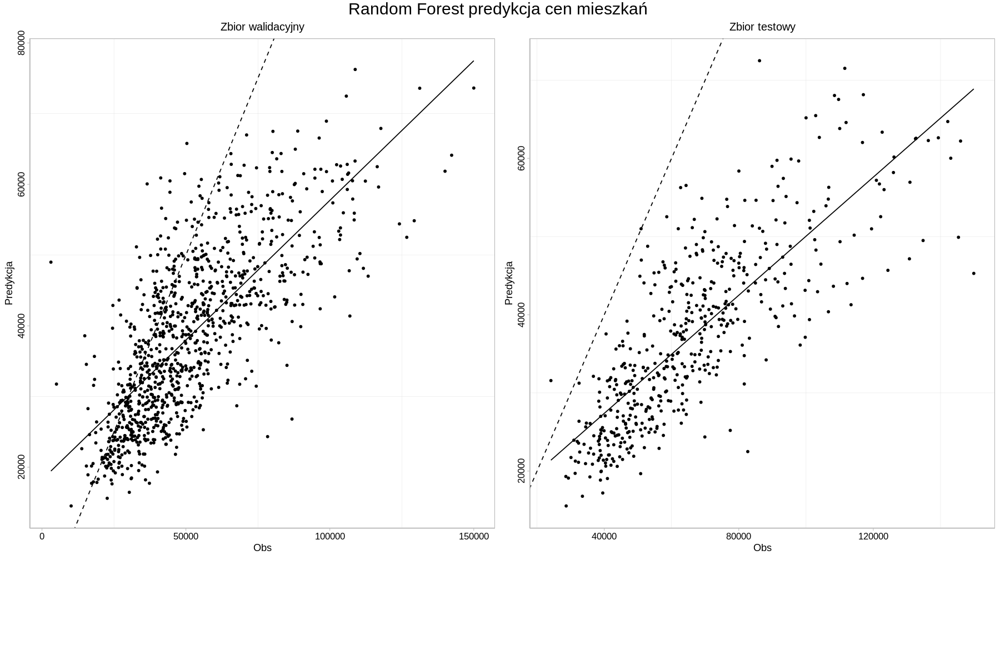

In [ ]:

#Wykres dopasowania
p.valid<-ggplot(data=XY_2016, aes(x=obs_2016, y=RF_2016))+ 
  geom_point(size = 1.0)+
  geom_smooth(method = "lm", se = FALSE, colour="black",size=0.5)+
  theme_light() +
  ggtitle("Zbior walidacyjny")+
  theme(
    plot.title = element_text(color="black", size=12,hjust = 0.5),
    panel.background = element_rect(fill = "white",colour = "gray75",size = 0.5, linetype = "solid"),
    axis.line = element_line(colour = "grey"),
    panel.grid.major = element_blank(),
    axis.text.x=element_text(size=10, colour="black"),
    axis.text.y=element_text(size=10,angle = 90,vjust = 0.5, hjust=0.5, colour='black'))+
  geom_abline(slope=1, intercept=0,linetype="dashed",size=0.5)+
  labs(x="Obs", y = "Predykcja") 

p.test<-ggplot(data=XY_2017, aes(x=obs_2017, y=RF_2017))+ 
  geom_point(size = 1.0)+
  geom_smooth(method = "lm", se = FALSE, colour="black",size=0.5)+
  theme_light() +
  ggtitle("Zbior testowy")+
  theme(
    plot.title = element_text(color="black", size=12,hjust = 0.5),
    panel.background = element_rect(fill = "white",colour = "gray75",size = 0.5, linetype = "solid"),
    axis.line = element_line(colour = "grey"),
    panel.grid.major = element_blank(),
    axis.text.x=element_text(size=10, colour="black"),
    axis.text.y=element_text(size=10,angle = 90,vjust = 0.5, hjust=0.5, colour='black'))+
  geom_abline(slope=1, intercept=0,linetype="dashed",size=0.5)+
  labs(x="Obs", y = "Predykcja") 
grid.arrange(p.valid,p.test, 
            ncol= 2, 
            heights = c(30,6), 
            top = textGrob("Random Forest predykcja cen mieszkań ",gp=gpar(fontsize=18)))


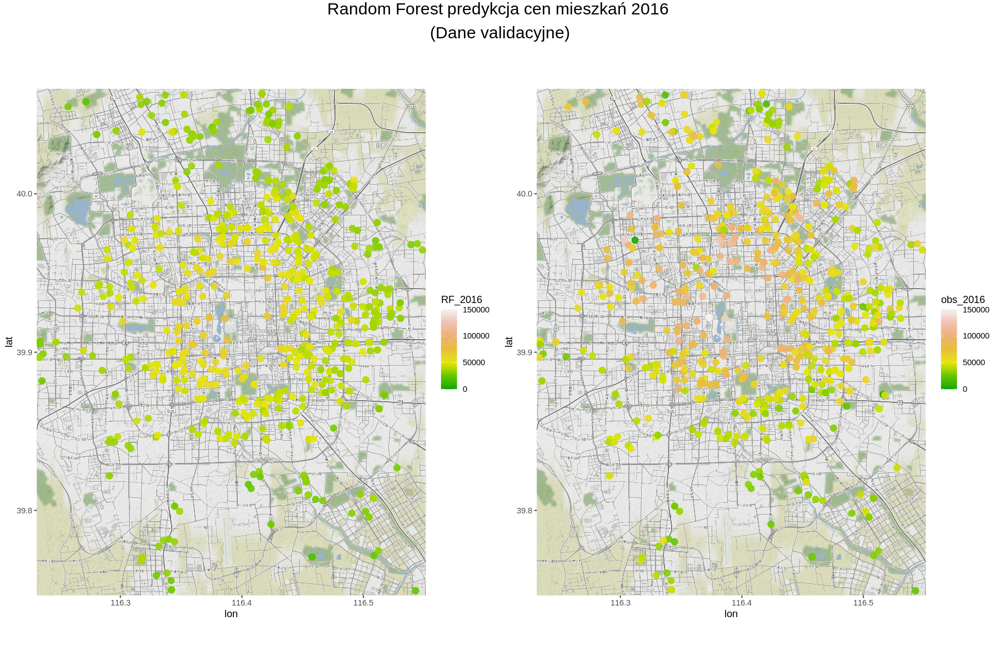

In [ ]:
pred = ggmap(map_pekin) +
    geom_point(data=XY_2016, aes(x=Lng, y=Lat, color=RF_2016), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2016$obs_2016,XY_2016$RF_2016)))
obs = ggmap(map_pekin) +
    geom_point(data=XY_2016, aes(x=Lng, y=Lat, color=obs_2016), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2016$obs_2016,XY_2016$RF_2016))) 


grid.arrange(pred, obs, nrow = 1, 
            widths = c(70, 70),
            top = textGrob("Random Forest predykcja cen mieszkań 2016 \n (Dane validacyjne) ", gp=gpar(fontsize=18)))

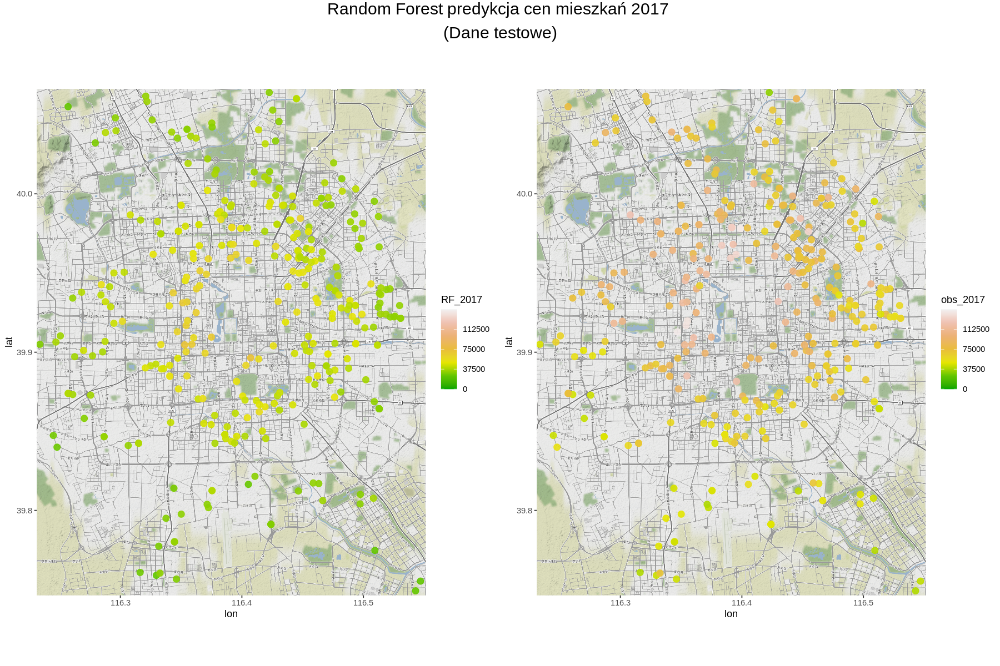

In [ ]:
pred = ggmap(map_pekin) +
    geom_point(data=XY_2017, aes(x=Lng, y=Lat, color=RF_2017), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2017$obs_2017,XY_2017$RF_2017)),
    breaks = c(0.0, 0.25*150000, 0.50*150000, 0.75*150000, 150000)) 
obs = ggmap(map_pekin) +
    geom_point(data=XY_2017, aes(x=Lng, y=Lat, color=obs_2017), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2017$obs_2017,XY_2017$RF_2017)), 
    breaks = c(0.0, 0.25*150000, 0.50*150000, 0.75*150000, 150000)) 


grid.arrange(pred, obs, nrow = 1, 
            widths = c(70, 70),
            top = textGrob("Random Forest predykcja cen mieszkań 2017 \n (Dane testowe) ", gp=gpar(fontsize=18)))

In [ ]:
features <- as.data.frame(train.hex) %>%  dplyr::select(-price)
response <- as.data.frame(train.hex) %>% pull(price)
#Funckja predykcyjna
pred <- function(object, newdata)  {
  results <- as.vector(h2o.predict(object, as.h2o(newdata)))
  return(results)
  }


per.var.imp<-vip(
  best_drf,
  train = as.data.frame(train.hex),
  method = "permute",
  target = "price",
  metric = "RMSE",
  nsim = 5,
  sample_frac = 0.5,
  pred_wrapper = pred
)
per.var.imp<-per.var.imp$data
# Skalowanie Feature Importance
per.var.imp$Rank<-(per.var.imp$Importance-min(per.var.imp$Importance))*100/(max(per.var.imp$Importance)-min(per.var.imp$Importance))
ggplot(per.var.imp, aes(y=Rank, x=reorder(Variable, +Rank))) +
  ylab('Importance') +
  xlab('')+
  geom_bar(stat="identity", width = 0.45,fill = "grey")+
  theme_bw() +
  theme(axis.line = element_line(colour = "black"),
        panel.grid.major = element_blank(),
        axis.text.y=element_text(size=12),
        axis.text.x = element_text(size=12),
        axis.title.x = element_text(size=12),
        axis.title.y = element_text(size=12))+
  coord_flip()+
  ggtitle("RF Feature Importance")


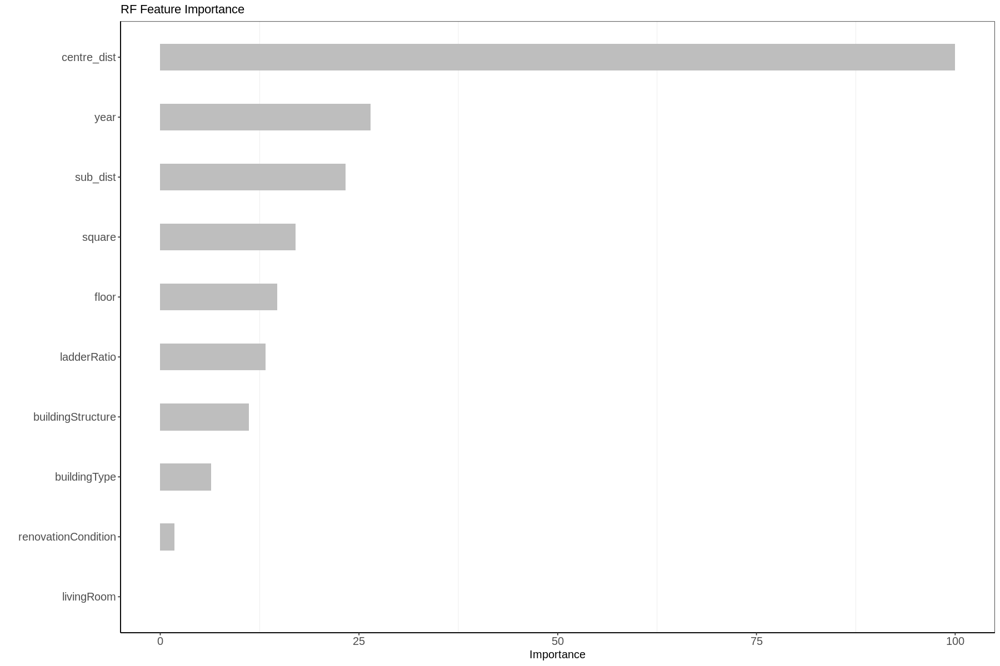

In [ ]:
# Skalowanie Feature Importance
per.var.imp$Rank<-(per.var.imp$Importance-min(per.var.imp$Importance))*100/(max(per.var.imp$Importance)-min(per.var.imp$Importance))
ggplot(per.var.imp, aes(y=Rank, x=reorder(Variable, +Rank))) +
  ylab('Importance') +
  xlab('')+
  geom_bar(stat="identity", width = 0.45,fill = "grey")+
  theme_bw() +
  theme(axis.line = element_line(colour = "black"),
        panel.grid.major = element_blank(),
        axis.text.y=element_text(size=12),
        axis.text.x = element_text(size=12),
        axis.title.x = element_text(size=12),
        axis.title.y = element_text(size=12))+
  coord_flip()+
  ggtitle("RF Feature Importance")

In [ ]:
#przygotowanie danych i SDF
xy <- df[,c(1:2)]
df_gwr<-df
mf<-df[,c(4:18)]
SPDF<-SpatialPointsDataFrame(coords = xy, data = mf)


In [ ]:
#Wybranie najlepszego kernelu
gwr.bw_exponential <- bw.gwr(price ~ square + livingRoom+drawingRoom+kitchen+bathRoom+floor+buildingType+
                   year+renovationCondition+buildingStructure+ladderRatio+elevator+centre_dist+sub_dist, 
                 data = SPDF, 
                 approach = "AICc", 
                 kernel = c('exponential'),  
                 adaptive = TRUE)
gwr.bw_gaussian <- bw.gwr(price ~ square + livingRoom+drawingRoom+kitchen+bathRoom+floor+buildingType+
                   year+renovationCondition+buildingStructure+ladderRatio+elevator+centre_dist+sub_dist, 
                 data = SPDF, 
                 approach = "AICc", 
                 kernel = c('gaussian'),  
                 adaptive = TRUE)
gwr.bw_tricube <- bw.gwr(price ~ square + livingRoom+drawingRoom+kitchen+bathRoom+floor+buildingType+
                   year+renovationCondition+buildingStructure+ladderRatio+elevator+centre_dist+sub_dist, 
                 data = SPDF, 
                 approach = "AICc", 
                 kernel = 'tricube',  
                 adaptive = TRUE)
gwr.bw_boxcar <- bw.gwr(price ~ square + livingRoom+drawingRoom+kitchen+bathRoom+floor+buildingType+
                   year+renovationCondition+buildingStructure+ladderRatio+elevator+centre_dist+sub_dist, 
                 data = SPDF, 
                 approach = "AICc", 
                 kernel = 'boxcar',  
                 adaptive = TRUE)

In [ ]:
cat('Gaussian: bw:', gwr.bw_gaussian,'AIC:',77320.78,'\n' )
cat('Exponential: bw:', gwr.bw_exponential,'AIC:',77305.41  ,'\n' )
cat('Tricube: bw:', gwr.bw_tricube,'AIC:',77347.98  ,'\n' )
cat('Boxcar: bw:', gwr.bw_boxcar,'AIC:',77520.67  ,'\n' )

Gaussian: bw: 75 AIC: 77320.78 
Exponential: bw: 64 AIC: 77305.41 
Tricube: bw: 721 AIC: 77347.98 
Boxcar: bw: 689 AIC: 77520.67 


In [ ]:
RESPONSE <- "price"
PREDICTORS <- c("square", "livingRoom","drawingRoom","kitchen","bathRoom","floor","buildingType","year", "renovationCondition", "buildingStructure", "ladderRatio", "elevator" ,'centre_dist', 'sub_dist')
model.sel <- model.selection.gwr(RESPONSE, PREDICTORS, 
                                 data = SPDF,
                                 kernel = "exponential", 
                                 adaptive = TRUE, 
                                 bw = 64)


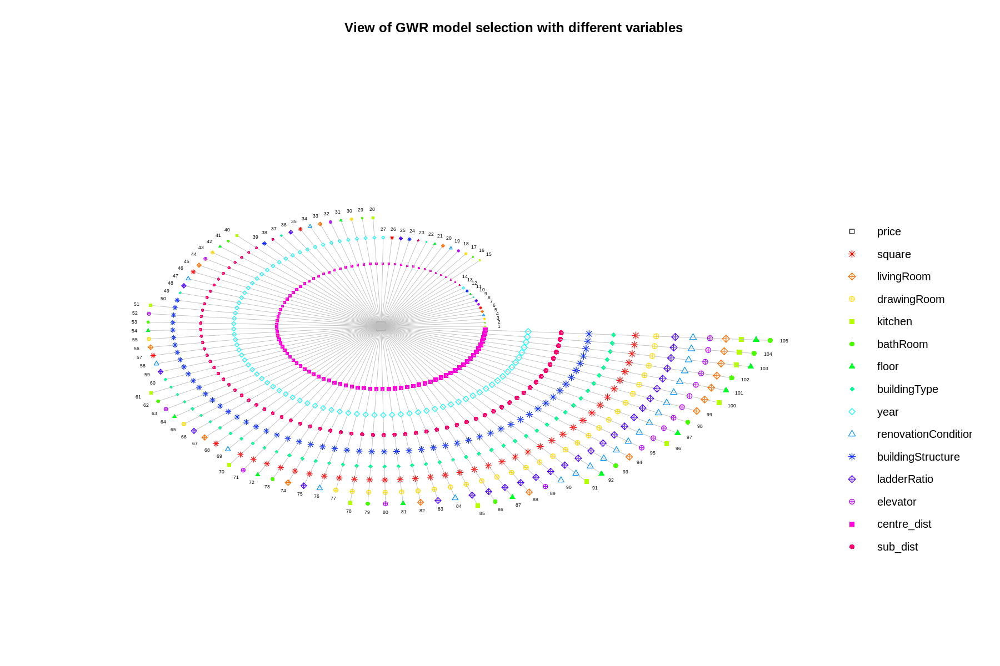

In [ ]:
sorted.models <- model.sort.gwr(model.sel, numVars = length(PREDICTORS),ruler.vector = model.sel[[2]][,2])
model.list <- sorted.models[[1]]
model.view.gwr(RESPONSE, PREDICTORS, model.list = model.list)


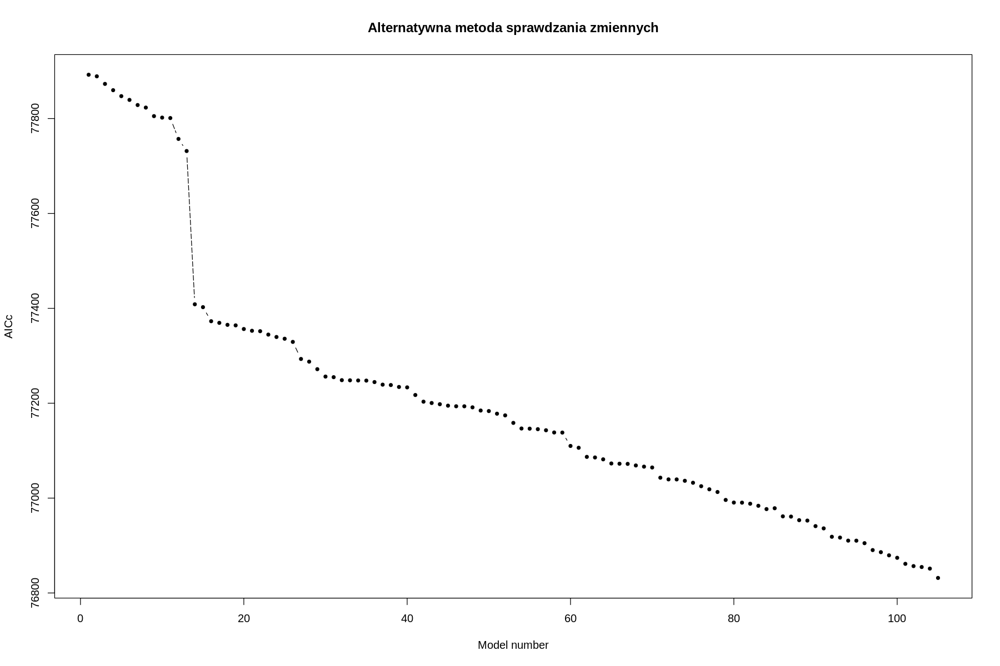

In [ ]:
plot(sorted.models[[2]][,2], col = "black", pch = 20, lty = 5,
    main = "Alternatywna metoda sprawdzania zmiennych",
    ylab = "AICc", xlab = "Model number", type = "b")


In [ ]:
#model GWR
gwr.res <- gwr.basic(price ~ square + livingRoom+drawingRoom+kitchen+bathRoom+floor+buildingType+
                   year+renovationCondition+buildingStructure+ladderRatio+elevator+centre_dist+sub_dist,
                     data = SPDF,
                     bw = gwr.bw_exponential, 
                     kernel = "exponential",   
                     adaptive = TRUE)
gwr.res

   ***********************************************************************
   *                       Package   GWmodel                             *
   ***********************************************************************
   Program starts at: 2023-01-22 20:35:22 
   Call:
   gwr.basic(formula = price ~ square + livingRoom + drawingRoom + 
    kitchen + bathRoom + floor + buildingType + year + renovationCondition + 
    buildingStructure + ladderRatio + elevator + centre_dist + 
    sub_dist, data = SPDF, bw = gwr.bw_exponential, kernel = "exponential", 
    adaptive = TRUE)

   Dependent (y) variable:  price
   Independent variables:  square livingRoom drawingRoom kitchen bathRoom floor buildingType year renovationCondition buildingStructure ladderRatio elevator centre_dist sub_dist
   Number of data points: 3500
   ***********************************************************************
   *                    Results of Global Regression                     *
   ******************

In [ ]:
#Zapisanie wspolczynnikow zamiast zmiennych
df_gwr$square<-gwr.res$SDF$square 
df_gwr$year<-gwr.res$SDF$year  
df_gwr$livingRoom<-gwr.res$SDF$livingRoom  
df_gwr$drawingRoom<-gwr.res$SDF$drawingRoom  
df_gwr$kitchen<-gwr.res$SDF$kitchen  
df_gwr$bathRoom<-gwr.res$SDF$bathRoom 
df_gwr$floor<-gwr.res$SDF$floor
df_gwr$buildingType<-gwr.res$SDF$buildingType
df_gwr$buildingStructure<-gwr.res$SDF$buildingStructure

df_gwr$renovationCondition<-gwr.res$SDF$renovationCondition
df_gwr$ladderRatio<-gwr.res$SDF$ladderRatio
df_gwr$elevator<-gwr.res$SDF$elevator
df_gwr$centre_dist<-gwr.res$SDF$centre_dist
df_gwr$sub_dist<-gwr.res$SDF$sub_dist
df_gwr$R2<-gwr.res$SDF$Local_R2


In [ ]:
#Funkcja rysująca wykres punkt-współczynnik
rgb.palette.col <- colorRampPalette(c("red","yellow", "green", "blue"),space = "rgb")

coef_plot = function(varialbe) {
  p<-levelplot(get(varialbe)~Lng+Lat,df_gwr,cex=0.6,
                aspect = "iso",main= paste("Local slope: ",varialbe) ,
                xlab="", ylab="",  
                scales=list(y=list(draw=T,cex=0.5,rot=90, tck= 0.5),x=list(draw=T, cex=0.5,tck= 0.6)),
                par.settings=list(axis.line=list(col="grey",lwd=0.5)),
                col.regions=rgb.palette.col (20),
                colorkey=list(space="right",width=1.2,labels=list(cex=1.2)),
                panel = function(...) {
                panel.levelplot.points(...)
                sp.polygons(state,lty=1,lwd=0.5,col="grey30")
                })
              return (p)
              }

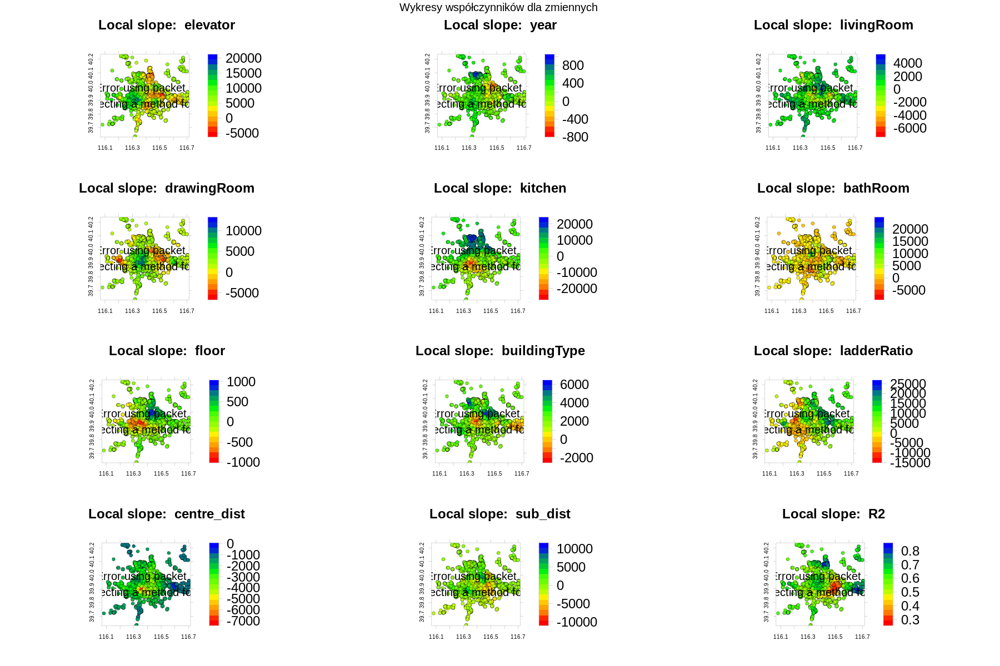

In [ ]:
elevator_slope = coef_plot('elevator')
year_slope = coef_plot('year')
livingRoom_slope = coef_plot('livingRoom')
drawingRoom_slope = coef_plot('drawingRoom')
kitchen_slope = coef_plot('kitchen')
bathRoom_slope = coef_plot('bathRoom')
floor_slope = coef_plot('floor')
buildingType_slope = coef_plot('buildingType')
ladderRatio_slope = coef_plot('ladderRatio')
centre_dist_slope = coef_plot('centre_dist')
sub_dist_slope = coef_plot('sub_dist')
Local_R2 = coef_plot('R2')

grid.arrange(elevator_slope, year_slope,livingRoom_slope, drawingRoom_slope,kitchen_slope,bathRoom_slope,floor_slope, 
            buildingType_slope,ladderRatio_slope, centre_dist_slope, sub_dist_slope,Local_R2,ncol=3,
            top = textGrob("Wykresy współczynników dla zmiennych "))

In [ ]:
#Utworzenie tabel z danymi GWR
train.gwr.df<-df_gwr %>% 
  filter(tradeTime == 2015)
valid.gwr.df<-df_gwr %>% 
  filter(tradeTime == 2016)
test.gwr.df<-df_gwr %>% 
  filter(tradeTime == 2017)

In [ ]:
h2o.init(nthreads = -1,max_mem_size ="48g",enable_assertions = FALSE)
test.gwr.mf<-test.gwr.df[, 4:18] 
valid.gwr.mf<-valid.gwr.df[, 4:18]
train.gwr.mf<-train.gwr.df[, 4:18]
test.gwr.hex<-  as.h2o(test.gwr.mf)
valid.gwr.hex<-  as.h2o(valid.gwr.mf)
train.gwr.hex<-  as.h2o(train.gwr.mf)

response <- "price"
predictors <- setdiff(names(train.gwr.hex), response)


In [ ]:
drf_hyper_params <-list(
              ntrees  = seq(10, 1000, by = 10),
              max_depth=seq(5, 40, by = 5),
              sample_rate=c(0.7, 0.8, 0.9, 1.0)
              )

#  serach criteria
drf_search_criteria <- list(strategy = "RandomDiscrete", 
                        max_models = 20,
                        max_runtime_secs = 900,
                        stopping_tolerance = 0.001,
                        stopping_rounds = 2,
                        seed = 384365)
# Grid Search
drf_grid <- h2o.grid(
                  algorithm="randomForest",
                  grid_id = "drf_grid_IDx",
                  x= predictors,
                  y = response,
                  training_frame = train.gwr.hex,
                  validation_frame = valid.gwr.hex,
                  stopping_metric = "RMSE",
                  nfolds=5,
                  keep_cross_validation_predictions = TRUE,
                  hyper_params = drf_hyper_params,
                  search_criteria = drf_search_criteria,
                  seed = 42)


In [ ]:
drf_get_grid <- h2o.getGrid("drf_grid_IDx",sort_by="RMSE",decreasing= FALSE)
drf_get_grid@summary_table[1,]

,max_depth,ntrees,sample_rate,model_ids,rmse
,<dbl>,<dbl>,<dbl>,<chr>,<dbl>
1,40,450,0.7,drf_grid_IDx_model_1,7076.216


In [ ]:
#Statystyki
best_drf <- h2o.getModel(drf_get_grid@model_ids[[1]]) 
best_drf


Model Details:

H2ORegressionModel: drf
Model ID:  drf_grid_IDx_model_1 
Model Summary: 
  number_of_trees number_of_internal_trees model_size_in_bytes min_depth
1             450                      450             5069587        20
  max_depth mean_depth min_leaves max_leaves mean_leaves
1        35   25.17111        863        924   892.87780


H2ORegressionMetrics: drf
** Reported on training data. **
** Metrics reported on Out-Of-Bag training samples **

MSE:  47139229
RMSE:  6865.801
MAE:  4534.817
RMSLE:  0.165597
Mean Residual Deviance :  47139229


H2ORegressionMetrics: drf
** Reported on validation data. **

MSE:  342007980
RMSE:  18493.46
MAE:  14576.17
RMSLE:  0.378934
Mean Residual Deviance :  342007980


H2ORegressionMetrics: drf
** Reported on cross-validation data. **
** 5-fold cross-validation on training data (Metrics computed for combined holdout predictions) **

MSE:  50072834
RMSE:  7076.216
MAE:  4739.644
RMSLE:  0.1721543
Mean Residual Deviance :  50072834


Cro

In [ ]:
cv.drf<-best_drf@model$cross_validation_metrics_summary%>%.[,c(1,2)]
cv.drf

,mean,sd
,<dbl>,<dbl>
mae,4.737061e+03,3.458395e+02
mean_residual_deviance,5.002742e+07,8.613290e+06
mse,5.002742e+07,8.613290e+06
r2,7.897694e-01,3.391701e-02
residual_deviance,5.002742e+07,8.613290e+06
rmse,7.051612e+03,6.146048e+02
rmsle,1.715883e-01,1.487732e-02


In [ ]:
XY_2016_gwr<-valid.gwr.df[,1:2]
XY_2017_gwr<-test.gwr.df[,1:2]
XY_2016_gwr$obs_2016<-valid.gwr.df[,16]
XY_2017_gwr$obs_2017<-test.gwr.df[,16]
# Predykcje
pred.gwr.valid<-as.data.frame(h2o.predict(object = best_drf, newdata = valid.gwr.hex))
pred.gwr.test<-as.data.frame(h2o.predict(object = best_drf, newdata = test.gwr.hex))
XY_2016_gwr$RF_2016<-pred.gwr.valid$predict
XY_2017_gwr$RF_2017<-pred.gwr.test$predict

In [ ]:
cat('RF&GWR Val RMSE:', round(sqrt(mean((XY_2016_gwr$RF_2016-XY_2016_gwr$obs_2016)^2 , na.rm = TRUE)), digits=3), '\n')
cat('RF&GWR Val MAE:', round(mean(abs(XY_2016_gwr$RF_2016-XY_2016_gwr$obs_2016) , na.rm = TRUE ), digits=3), '\n')
cat('RF&GWR Val R2:', round(summary(lm(obs_2016~RF_2016,XY_2016_gwr))$r.squared, digits=3), '\n')
cat('RF&GWR Test RMSE:', round(sqrt(mean((XY_2017_gwr$RF_2017-XY_2017_gwr$obs_2017)^2 , na.rm = TRUE)), digits=3), '\n')
cat('RF&GWR Test MAE:', round(mean(abs(XY_2017_gwr$RF_2017-XY_2017_gwr$obs_2017) , na.rm = TRUE ), digits=3), '\n')
cat('RF&GWR Test R2:', round(summary(lm(obs_2017~RF_2017,XY_2017_gwr))$r.squared, digits=3), '\n')


RF&GWR Val RMSE: 18493.46 
RF&GWR Val MAE: 14576.17 
RF&GWR Val R2: 0.706 
RF&GWR Test RMSE: 32276.42 
RF&GWR Test MAE: 29292.27 
RF&GWR Test R2: 0.787 


`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


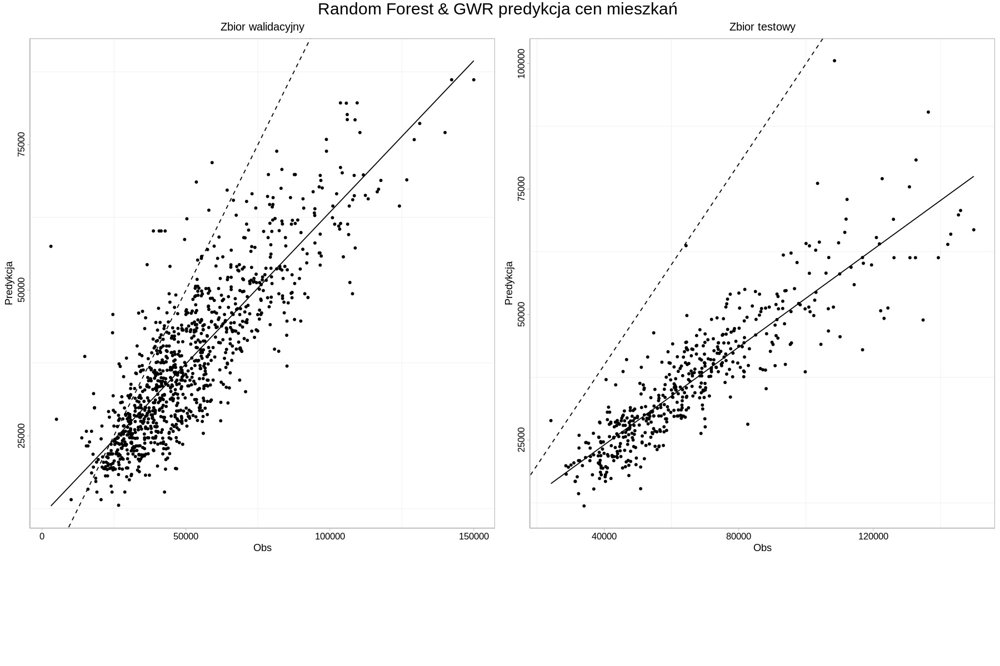

In [ ]:
p.valid<-ggplot(data=XY_2016_gwr, aes(x=obs_2016, y=RF_2016))+ 
  geom_point(size = 1.0)+
  geom_smooth(method = "lm", se = FALSE, colour="black",size=0.5)+
  theme_light() +
  ggtitle("Zbior walidacyjny")+
  theme(
    plot.title = element_text(color="black", size=12,hjust = 0.5),
    panel.background = element_rect(fill = "white",colour = "gray75",size = 0.5, linetype = "solid"),
    axis.line = element_line(colour = "grey"),
    panel.grid.major = element_blank(),
    axis.text.x=element_text(size=10, colour="black"),
    axis.text.y=element_text(size=10,angle = 90,vjust = 0.5, hjust=0.5, colour='black'))+
  geom_abline(slope=1, intercept=0,linetype="dashed",size=0.5)+
  labs(x="Obs", y = "Predykcja") 

p.test<-ggplot(data=XY_2017_gwr, aes(x=obs_2017, y=RF_2017))+ 
  geom_point(size = 1.0)+
  geom_smooth(method = "lm", se = FALSE, colour="black",size=0.5)+
  theme_light() +
  ggtitle("Zbior testowy")+
  theme(
    plot.title = element_text(color="black", size=12,hjust = 0.5),
    panel.background = element_rect(fill = "white",colour = "gray75",size = 0.5, linetype = "solid"),
    axis.line = element_line(colour = "grey"),
    panel.grid.major = element_blank(),
    axis.text.x=element_text(size=10, colour="black"),
    axis.text.y=element_text(size=10,angle = 90,vjust = 0.5, hjust=0.5, colour='black'))+
  geom_abline(slope=1, intercept=0,linetype="dashed",size=0.5)+
  labs(x="Obs", y = "Predykcja") 
grid.arrange(p.valid,p.test, 
            ncol= 2, 
            heights = c(30,6), 
            top = textGrob("Random Forest & GWR predykcja cen mieszkań ",gp=gpar(fontsize=18)))


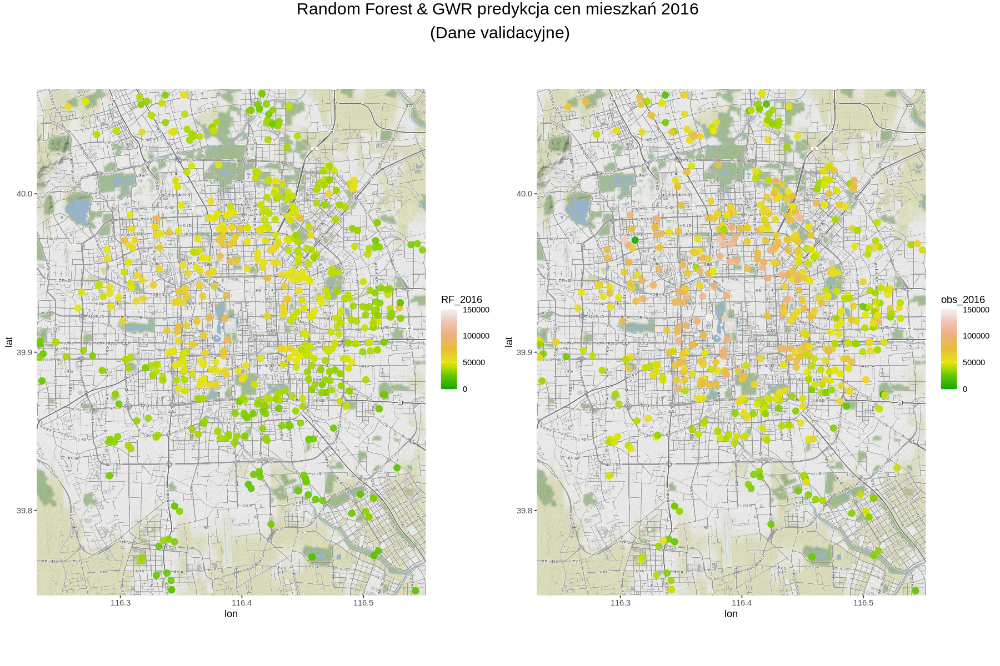

In [ ]:
pred = ggmap(map_pekin) +
    geom_point(data=XY_2016_gwr, aes(x=Lng, y=Lat, color=RF_2016), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2016_gwr$obs_2016,XY_2016_gwr$RF_2016)))
obs = ggmap(map_pekin) +
    geom_point(data=XY_2016_gwr, aes(x=Lng, y=Lat, color=obs_2016), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2016_gwr$obs_2016,XY_2016_gwr$RF_2016)))


grid.arrange(pred, obs, nrow = 1, 
            widths = c(70, 70),
            top = textGrob("Random Forest & GWR predykcja cen mieszkań 2016 \n (Dane validacyjne) ", gp=gpar(fontsize=18)))

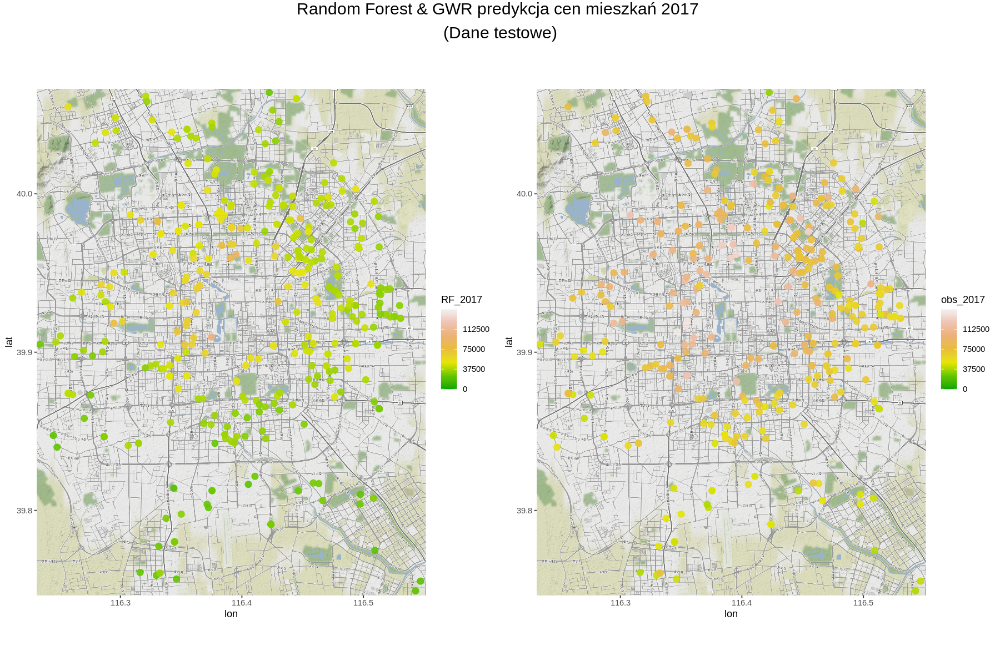

In [ ]:
pred = ggmap(map_pekin) +
    geom_point(data=XY_2017_gwr, aes(x=Lng, y=Lat, color=RF_2017), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2017_gwr$obs_2017,XY_2017_gwr$RF_2017)),
    breaks = c(0.0, 0.25*150000, 0.50*150000, 0.75*150000, 150000)) 
obs = ggmap(map_pekin) +
    geom_point(data=XY_2017_gwr, aes(x=Lng, y=Lat, color=obs_2017), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2017_gwr$obs_2017,XY_2017_gwr$RF_2017)), 
    breaks = c(0.0, 0.25*150000, 0.50*150000, 0.75*150000, 150000)) 
grid.arrange(pred, obs, nrow = 1, 
            widths = c(70, 70),
            top = textGrob("Random Forest & GWR predykcja cen mieszkań 2017 \n (Dane testowe) ", gp=gpar(fontsize=18)))

In [ ]:
features <- as.data.frame(train.gwr.hex) %>%  dplyr::select(-price)
response <- as.data.frame(train.gwr.hex) %>% pull(price)
pred <- function(object, newdata)  {
  results <- as.vector(h2o.predict(object, as.h2o(newdata)))
  return(results)
  }

In [ ]:
per.var.imp<-vip(
  best_drf,
  train = as.data.frame(train.gwr.hex),
  method = "permute",
  target = "price",
  metric = "RMSE",
  nsim = 5,
  sample_frac = 0.5,
  pred_wrapper = pred
)


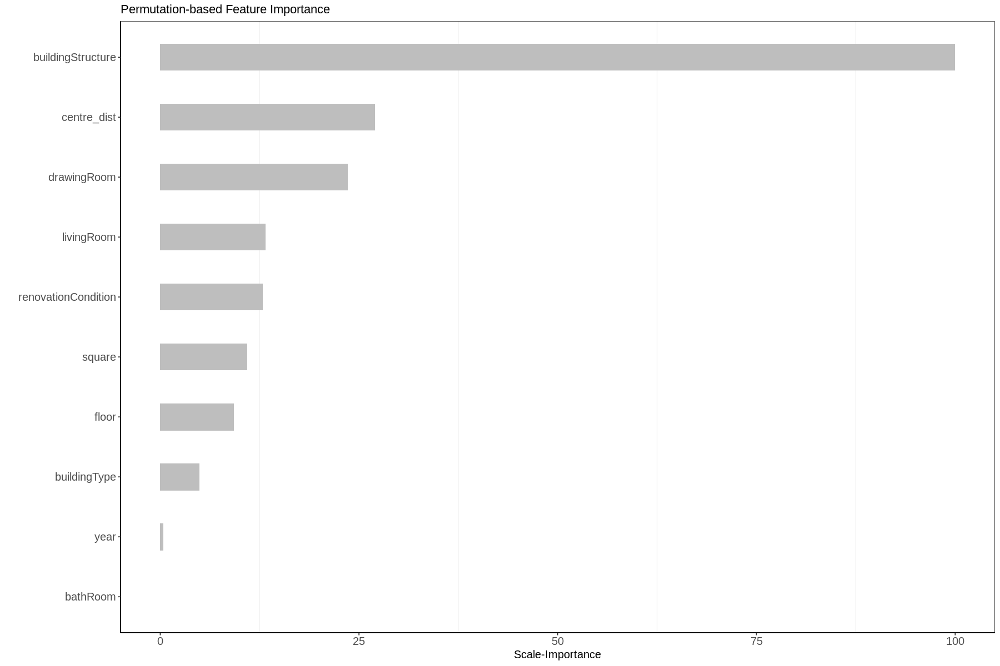

In [ ]:
per.var.imp<-per.var.imp$data
per.var.imp$Rank<-(per.var.imp$Importance-min(per.var.imp$Importance))*100/(max(per.var.imp$Importance)-min(per.var.imp$Importance))
ggplot(per.var.imp, aes(y=Rank, x=reorder(Variable, +Rank))) +
  ylab('Scale-Importance') +
  xlab('')+
  geom_bar(stat="identity", width = 0.45,fill = "grey")+
  theme_bw() +
  theme(axis.line = element_line(colour = "black"),
        panel.grid.major = element_blank(),
        axis.text.y=element_text(size=12),
        axis.text.x = element_text(size=12),
        axis.title.x = element_text(size=12),
        axis.title.y = element_text(size=12))+
  coord_flip()+
  ggtitle("Feature Importance")


In [ ]:
#przygotowanie danych
XY_2016<-valid.df[,1:2]
XY_2017<-test.df[,1:2]
XY_2016$obs_2016<-valid.df[,16]
XY_2017$obs_2017<-test.df[,16]


In [ ]:
#Model GWRF
Coords<-train.df[,1:2]
grf.model <- grf(price ~ square + livingRoom+drawingRoom+kitchen+bathRoom+floor+buildingType+
                   year+renovationCondition+buildingStructure+ladderRatio+elevator+centre_dist+sub_dist,
                 dframe=train.df, 
                 bw=200,
                 ntree=440, 
                 mtry = 2,
                 kernel="fixed",
                 forests = TRUE,
                 coords=Coords)


Number of Observations: 2000

Number of Independent Variables: 14

Kernel: Fixed
Bandwidth: 200


--------------- Global Model Summary ---------------




Ranger result

Call:
 ranger(price ~ square + livingRoom + drawingRoom + kitchen +      bathRoom + floor + buildingType + year + renovationCondition +      buildingStructure + ladderRatio + elevator + centre_dist +      sub_dist, data = train.df, num.trees = 440, mtry = 2, importance = "impurity",      num.threads = NULL) 

Type:                             Regression 
Number of trees:                  440 
Sample size:                      2000 
Number of independent variables:  14 
Mtry:                             2 
Target node size:                 5 
Variable importance mode:         impurity 
Splitrule:                        variance 
OOB prediction error (MSE):       95095744 
R squared (OOB):                  0.6012681 



Importance:




             square          livingRoom         drawingRoom             kitchen 
        37051528735          8124174613          5460782456          2839732165 
           bathRoom               floor        buildingType                year 
         5725851860         21601064778          7471388470         40383661171 
renovationCondition   buildingStructure         ladderRatio            elevator 
         7176049342         10055560181         21253648895          4321857296 
        centre_dist            sub_dist 
       164528859264         49775948500 



Mean Square Error (Not OBB): 38799442.223

R-squared (Not OBB) %: 83.723

AIC (Not OBB): 34977.833

AICc (Not OBB): 34978.075


--------------- Local Model Summary ---------------



Residuals OOB:




    Min.  1st Qu.   Median     Mean  3rd Qu.     Max. 
-42402.0  -5782.9  -1750.2      4.3   3840.5  73167.2 



Residuals Predicted (Not OBB):




     Min.   1st Qu.    Median      Mean   3rd Qu.      Max. 
-28496.64  -3801.24  -1081.04      8.83   2627.54  43886.17 



Local Variable Importance:




                             Min          Max         Mean        StD
square               33484280823  38481977796  36043798236  754954122
livingRoom            7248987357   8285792149   7774154370  151007108
drawingRoom           4877559139   5731998881   5294386296  125184726
kitchen               2256139314   3803173528   3012251830  198924249
bathRoom              4910848166   6480858364   5608502384  218519640
floor                20478591086  23075725288  21705343320  371650036
buildingType          6767689629   7915787429   7369806799  170534176
year                 37503303938  43854043891  40532172412 1008611375
renovationCondition   6976665601   7902111162   7410082576  130546587
buildingStructure     9438293126  11401748695  10377046444  283841709
ladderRatio          19203821112  22162470372  20712877804  420480830
elevator              3713228339   5128850380   4309937069  178763590
centre_dist         154463280355 175517763292 165109779982 2815468175
sub_dist            


Mean squared error (OOB): 92677601.057

R-squared (OOB) %: 61.121

AIC (OBB): 36719.275

AICc (OBB): 36719.517

Mean squared error Predicted (Not OBB): 38748604.56

R-squared Predicted (Not OBB) %: 83.745

AIC Predicted (Not OBB): 34975.211

AICc Predicted (Not OBB): 34975.453


Calculation time (in seconds): 2.7552



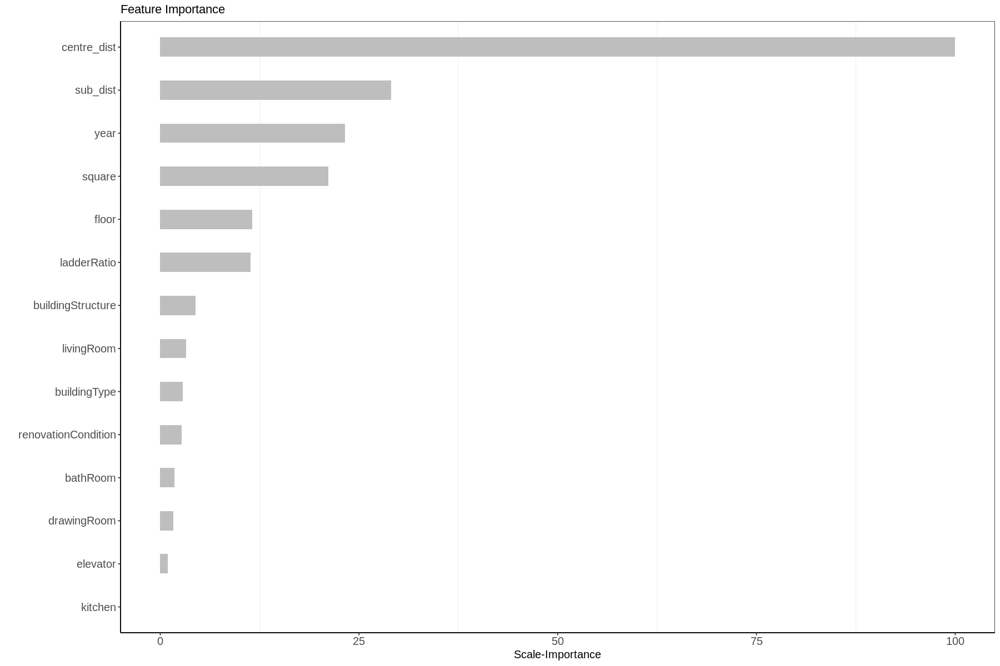

In [ ]:
dr = grf.model$Global.Model$variable.importance[['drawingRoom']]
lr = grf.model$Global.Model$variable.importance[['livingRoom']]
kc = grf.model$Global.Model$variable.importance[['kitchen']]
br = grf.model$Global.Model$variable.importance[['bathRoom']]
fl = grf.model$Global.Model$variable.importance[['floor']]
bt = grf.model$Global.Model$variable.importance[['buildingType']]
yr = grf.model$Global.Model$variable.importance[['year']]
rc = grf.model$Global.Model$variable.importance[['renovationCondition']]
bs = grf.model$Global.Model$variable.importance[['buildingStructure']]
lrat = grf.model$Global.Model$variable.importance[['ladderRatio']]
el = grf.model$Global.Model$variable.importance[['elevator']]
sq = grf.model$Global.Model$variable.importance[['square']]
cd = grf.model$Global.Model$variable.importance[['centre_dist']]
sd = grf.model$Global.Model$variable.importance[['sub_dist']]

FI <- data.frame(Wartosci = c(sq,dr,lr,kc,br,fl,bt,yr,rc,bs,lrat,el, cd, sd), 
                 Etykiety = c('square',"drawingRoom","livingRoom","kitchen", 'bathRoom', 'floor', 'buildingType', 'year',
                 'renovationCondition','buildingStructure', 'ladderRatio', 'elevator', 'centre_dist','sub_dist'))
FI$Rank<-(FI$Wartosc-min(FI$Wartosc))*100/(max(FI$Wartosc)-min(FI$Wartosc))
ggplot(FI, aes(y=Rank, x=reorder(Etykiety, +Rank))) +
  ylab('Scale-Importance') +
  xlab('')+
  geom_bar(stat="identity", width = 0.45,fill = "grey")+
  theme_bw() +
  theme(axis.line = element_line(colour = "black"),
        panel.grid.major = element_blank(),
        axis.text.y=element_text(size=12),
        axis.text.x = element_text(size=12),
        axis.title.x = element_text(size=12),
        axis.title.y = element_text(size=12))+
  coord_flip()+
  ggtitle("Feature Importance")


In [ ]:
cat('Global MSE:', grf.model$Global.Model$prediction.error, '\n')
cat('Global RMSE:', sqrt(grf.model$Global.Model$prediction.error), '\n')
cat('Global R2:', grf.model$Global.Model$r.squared, '\n')

Global MSE: 95095744 
Global RMSE: 9751.705 
Global R2: 0.6012681 


In [ ]:
grf.model$LocalModelSummary


,Min,Max,Mean,StD
,<dbl>,<dbl>,<dbl>,<dbl>
square,33484280823,38481977796,36043798236,754954122
livingRoom,7248987357,8285792149,7774154370,151007108
drawingRoom,4877559139,5731998881,5294386296,125184726
kitchen,2256139314,3803173528,3012251830,198924249
bathRoom,4910848166,6480858364,5608502384,218519640
floor,20478591086,23075725288,21705343320,371650036
buildingType,6767689629,7915787429,7369806799,170534176
year,37503303938,43854043891,40532172412,1008611375
renovationCondition,6976665601,7902111162,7410082576,130546587


In [ ]:
cat('Local RMSE:', sqrt(grf.model$LocalModelSummary$l.MSE.Pred), '\n')


Local RMSE: 6224.838 


In [ ]:
#Predykcje
XY_2016$GWRF_2016<-predict.grf(grf.model, valid.df, x.var.name="Lng", y.var.name="Lat", local.w=1, global.w=0)
XY_2017$GWRF_2017<-predict.grf(grf.model, test.df, x.var.name="Lng", y.var.name="Lat", local.w=1, global.w=0)


In [ ]:
cat('RF Val RMSE:', round(sqrt(mean((XY_2016$GWRF_2016-XY_2016$obs_2016)^2 , na.rm = TRUE)), digits=3), '\n')
cat('RF Val R2:', round(summary(lm(obs_2016~GWRF_2016,XY_2016))$r.squared, digits=3), '\n')
cat('RF Test RMSE:', round(sqrt(mean((XY_2017$GWRF_2017-XY_2017$obs_2017)^2 , na.rm = TRUE)), digits=3), '\n')
cat('RF Test MAE:', round(mean(abs(XY_2017$GWRF_2017-XY_2017$obs_2017) , na.rm = TRUE ), digits=3), '\n')
cat('RF Test R2:', round(summary(lm(obs_2017~GWRF_2017,XY_2017))$r.squared, digits=3), '\n')


RF Validation RMSE: 20840.69 
RF Validation MAE: 14952.87 
RF Validation R2: 0.493 
RF Test RMSE: 33109.78 
RF Test MAE: 28181.35 
RF Test R2: 0.6 


In [ ]:
bathRoomIm = grf.model$Local.Variable.Importance['bathRoom']
buildingStructureIm = grf.model$Local.Variable.Importance['buildingStructure']
drawingRoomIm = grf.model$Local.Variable.Importance['drawingRoom']
livingRoomIm = grf.model$Local.Variable.Importance['livingRoom']
kitchenIm = grf.model$Local.Variable.Importance['kitchen']
floorIm = grf.model$Local.Variable.Importance['floor']
buildingTypeIm = grf.model$Local.Variable.Importance['buildingType']
yearIm = grf.model$Local.Variable.Importance['year']
renovationConditionIm = grf.model$Local.Variable.Importance['renovationCondition']
buildingStructureIm = grf.model$Local.Variable.Importance['buildingStructure']
ladderRatioIm = grf.model$Local.Variable.Importance['ladderRatio']
elevatorIm = grf.model$Local.Variable.Importance['elevator']
squareIm = grf.model$Local.Variable.Importance['square']
centre_distIm = grf.model$Local.Variable.Importance['centre_dist']
sub_distIm = grf.model$Local.Variable.Importance['sub_dist']

local_importance = data.frame(c(train.df['Lng'], train.df['Lat'],squareIm,bathRoomIm,buildingStructureIm,drawingRoomIm,
livingRoomIm,kitchenIm,floorIm,buildingTypeIm,yearIm,renovationConditionIm,buildingStructureIm,
ladderRatioIm,elevatorIm,centre_distIm,sub_distIm))

In [ ]:
#Feature importance dla kazdej obserwacji. Wyskalowane dla kazdej zmiennej
local_importance$bathRoom<-(local_importance$bathRoom-min(local_importance$bathRoom))*100/(max(local_importance$bathRoom)-min(local_importance$bathRoom))
local_importance$buildingStructure<-(local_importance$buildingStructure-min(local_importance$buildingStructure))*100/(max(local_importance$buildingStructure)-min(local_importance$buildingStructure))
local_importance$drawingRoom<-(local_importance$drawingRoom-min(local_importance$drawingRoom))*100/(max(local_importance$drawingRoom)-min(local_importance$drawingRoom))
local_importance$livingRoom<-(local_importance$livingRoom-min(local_importance$livingRoom))*100/(max(local_importance$livingRoom)-min(local_importance$livingRoom))
local_importance$kitchen<-(local_importance$kitchen-min(local_importance$kitchen))*100/(max(local_importance$kitchen)-min(local_importance$kitchen))
local_importance$floor<-(local_importance$floor-min(local_importance$floor))*100/(max(local_importance$floor)-min(local_importance$floor))
local_importance$buildingType<-(local_importance$buildingType-min(local_importance$buildingType))*100/(max(local_importance$buildingType)-min(local_importance$buildingType))
local_importance$year<-(local_importance$year-min(local_importance$year))*100/(max(local_importance$year)-min(local_importance$year))
local_importance$renovationCondition<-(local_importance$renovationCondition-min(local_importance$renovationCondition))*100/(max(local_importance$renovationCondition)-min(local_importance$renovationCondition))
local_importance$ladderRatio<-(local_importance$ladderRatio-min(local_importance$ladderRatio))*100/(max(local_importance$ladderRatio)-min(local_importance$ladderRatio))
local_importance$elevator<-(local_importance$elevator-min(local_importance$elevator))*100/(max(local_importance$elevator)-min(local_importance$elevator))
local_importance$square<-(local_importance$square-min(local_importance$square))*100/(max(local_importance$square)-min(local_importance$square))
local_importance$centre_dist<-(local_importance$centre_dist-min(local_importance$centre_dist))*100/(max(local_importance$centre_dist)-min(local_importance$centre_dist))
local_importance$sub_dist<-(local_importance$sub_dist-min(local_importance$sub_dist))*100/(max(local_importance$sub_dist)-min(local_importance$sub_dist))


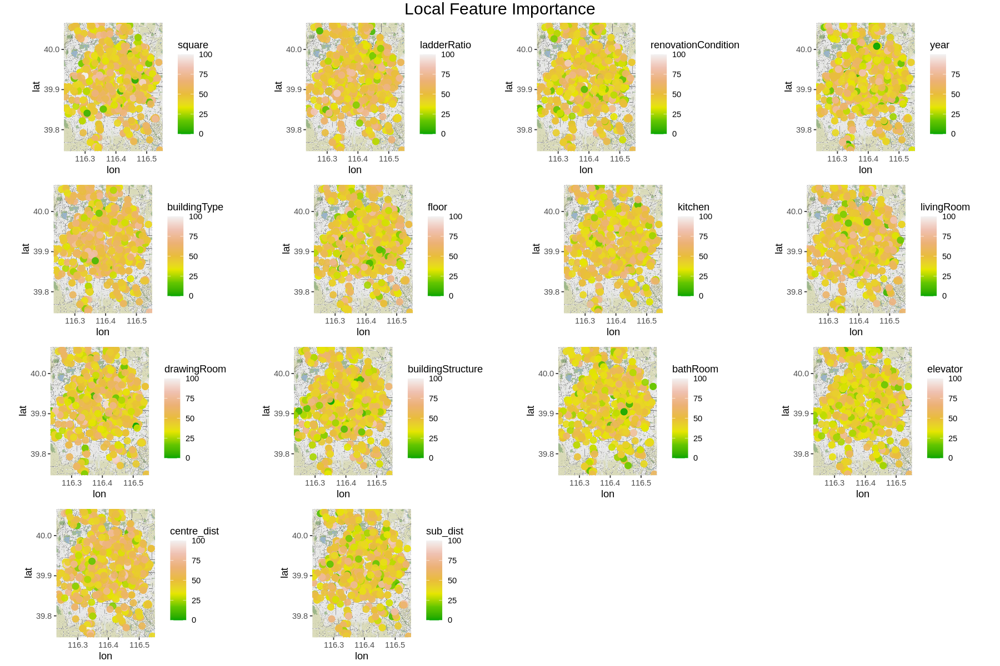

In [ ]:
elev = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=elevator), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
bath = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=bathRoom), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
BS = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=buildingStructure), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
DR = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=drawingRoom), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
LR = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=livingRoom), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
KN = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=kitchen), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
FL = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=floor), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
BT = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=buildingType), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
YR = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=year), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
RC = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=renovationCondition), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7))  
LRAT = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=ladderRatio), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
SQ = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=square), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
CD = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=centre_dist), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 
SD = ggmap(map_pekin) +
  geom_point(data=local_importance, aes(x=Lng, y=Lat, color=sub_dist), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 

grid.arrange(SQ, LRAT,RC, YR,BT,FL,KN,LR,DR,BS,bath,elev,CD,SD,
            top = textGrob("Local Feature Importance", gp=gpar(fontsize=18)))

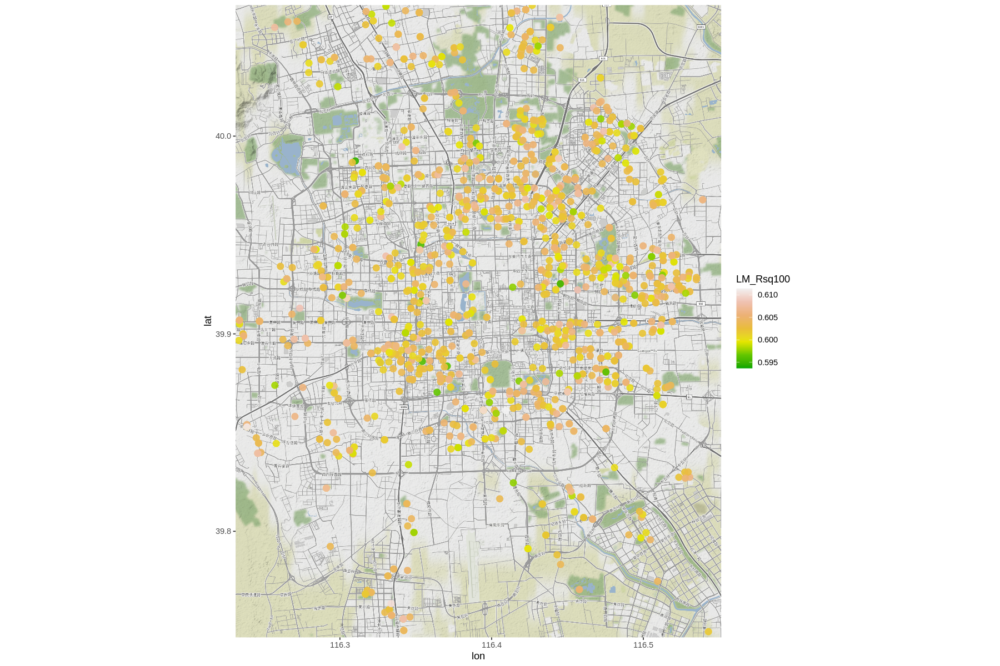

In [ ]:
GOF = grf.model$LGofFit['LM_Rsq100']

GOF_DF = data.frame(c(train.df['Lng'], train.df['Lat'],GOF ))

ggmap(map_pekin) +
  geom_point(data=GOF_DF, aes(x=Lng, y=Lat, color=LM_Rsq100), alpha=0.9, size=3) + 
  scale_colour_gradientn(colours = terrain.colors(n = 7)) 


`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


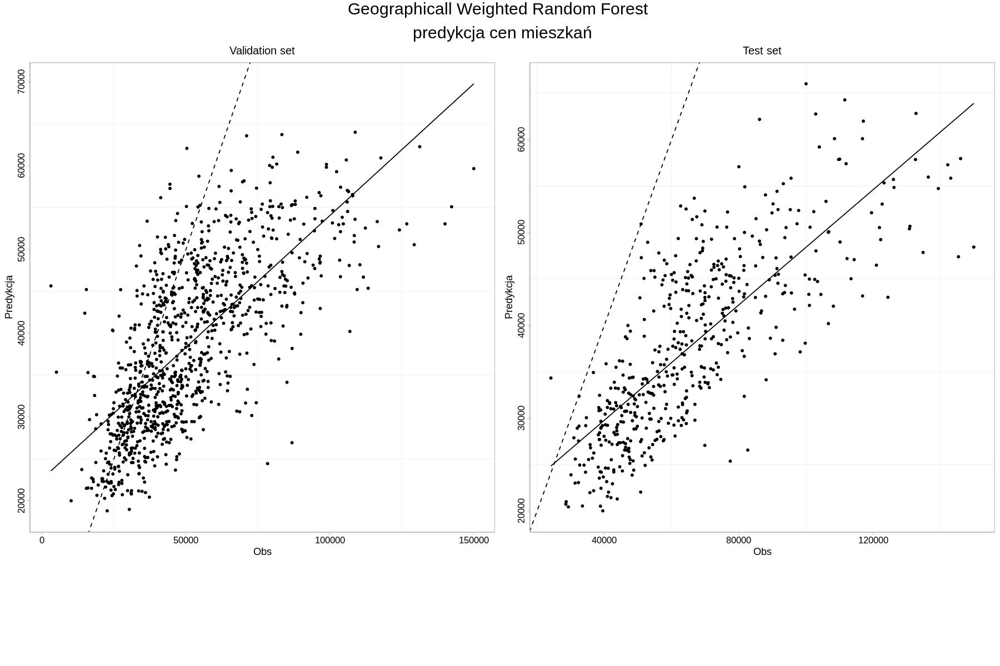

In [ ]:
p.valid<-ggplot(data=XY_2016, aes(x=obs_2016, y=GWRF_2016))+ 
  geom_point(size = 1.0)+
  geom_smooth(method = "lm", se = FALSE, colour="black",size=0.5)+
  theme_light() +
  ggtitle("Validation set")+
  theme(
    plot.title = element_text(color="black", size=12,hjust = 0.5),
    panel.background = element_rect(fill = "white",colour = "gray75",size = 0.5, linetype = "solid"),
    axis.line = element_line(colour = "grey"),
    panel.grid.major = element_blank(),
    axis.text.x=element_text(size=10, colour="black"),
    axis.text.y=element_text(size=10,angle = 90,vjust = 0.5, hjust=0.5, colour='black'))+
  geom_abline(slope=1, intercept=0,linetype="dashed",size=0.5)+
  labs(x="Obs", y = "Predykcja") 

p.test<-ggplot(data=XY_2017, aes(x=obs_2017, y=GWRF_2017))+ 
  geom_point(size = 1.0)+
  geom_smooth(method = "lm", se = FALSE, colour="black",size=0.5)+
  theme_light() +
  ggtitle("Test set")+
  theme(
    plot.title = element_text(color="black", size=12,hjust = 0.5),
    panel.background = element_rect(fill = "white",colour = "gray75",size = 0.5, linetype = "solid"),
    axis.line = element_line(colour = "grey"),
    panel.grid.major = element_blank(),
    axis.text.x=element_text(size=10, colour="black"),
    axis.text.y=element_text(size=10,angle = 90,vjust = 0.5, hjust=0.5, colour='black'))+
  geom_abline(slope=1, intercept=0,linetype="dashed",size=0.5)+
  labs(x="Obs", y = "Predykcja") 
grid.arrange(p.valid,p.test, 
            ncol= 2, 
            heights = c(30,6), 
            top = textGrob("Geographicall Weighted Random Forest \n  predykcja cen mieszkań ",gp=gpar(fontsize=18)))


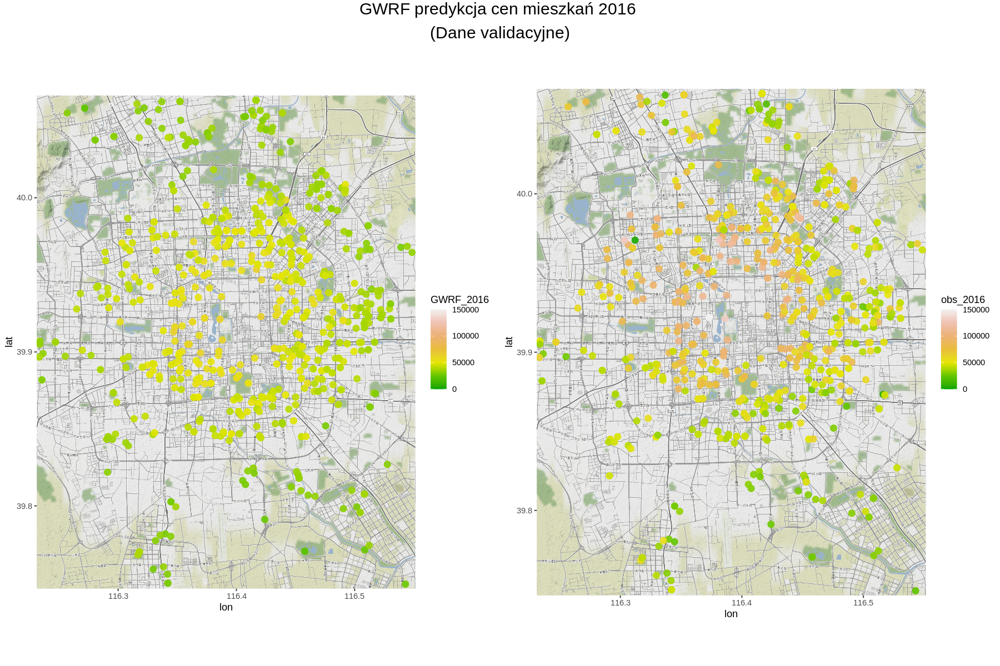

In [ ]:
pred = ggmap(map_pekin) +
    geom_point(data=XY_2016, aes(x=Lng, y=Lat, color=GWRF_2016), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2016$obs_2016,XY_2016$RF_2016)))

obs = ggmap(map_pekin) +
    geom_point(data=XY_2016, aes(x=Lng, y=Lat, color=obs_2016), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2016$obs_2016,XY_2016$RF_2016)))


grid.arrange(pred, obs, nrow = 1, 
            widths = c(70, 70),
            top = textGrob("GWRF predykcja cen mieszkań 2016 \n (Dane validacyjne) ", gp=gpar(fontsize=18)))

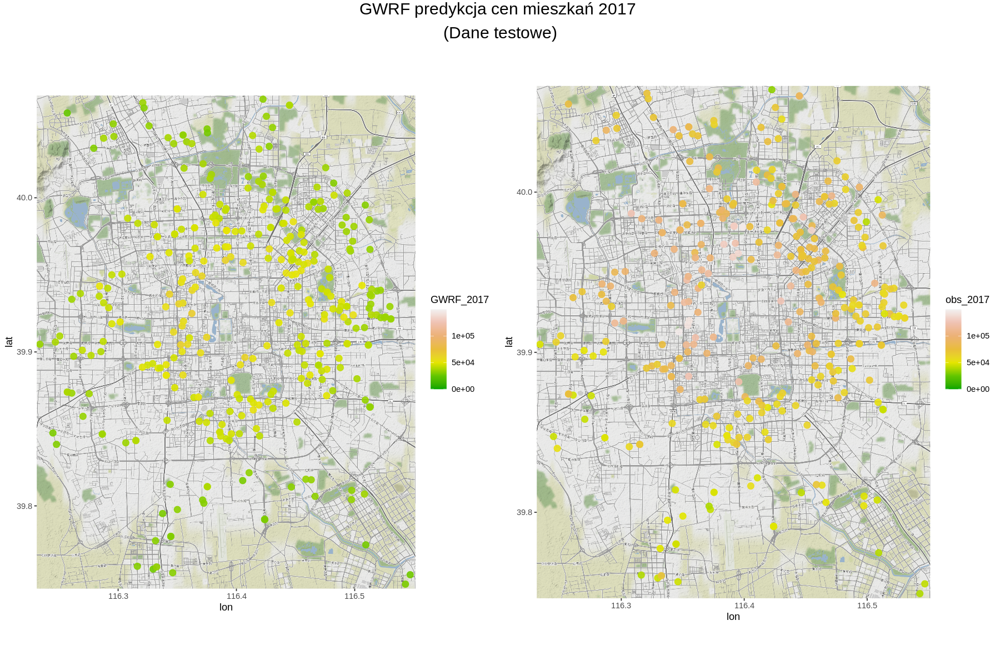

In [ ]:
pred = ggmap(map_pekin) +
    geom_point(data=XY_2017, aes(x=Lng, y=Lat, color=GWRF_2017), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2017$obs_2017,XY_2017$RF_2017)))

obs = ggmap(map_pekin) +
    geom_point(data=XY_2017, aes(x=Lng, y=Lat, color=obs_2017), alpha=0.9, size=3) + 
    scale_colour_gradientn(colours = terrain.colors(n = 7), 
    limits=c(0,max(XY_2017$obs_2017,XY_2017$RF_2017)))


grid.arrange(pred, obs, nrow = 1, 
            widths = c(70, 70),
            top = textGrob("GWRF predykcja cen mieszkań 2017 \n (Dane testowe) ", gp=gpar(fontsize=18)))